### **Time series Weather Forecasting**

In [16]:
# time series library import
import os  # Importing os module for operating system functions
import datetime  # Importing datetime module for date and time operations
import pandas as pd  # Importing pandas library and aliasing it as pd for data manipulation
import numpy as np  # Importing numpy library and aliasing it as np for numerical computations
import matplotlib as mpl  # Importing matplotlib library and aliasing it as mpl for plotting
import matplotlib.pyplot as plt  # Importing pyplot submodule from matplotlib for plotting
import seaborn as sns  # Importing seaborn library for statistical data visualization
import tensorflow as tf  # Importing TensorFlow library for machine learning tasks
import plotly.express as px  # Importing plotly express for interactive plotting
from statsmodels.tsa.seasonal import seasonal_decompose  # Importing seasonal_decompose function from statsmodels for time series decomposition

In [17]:
# Managing figure size at the beginning of the code
mpl.rcParams['figure.figsize'] = (15,6)  # Sets the default figure size to 15 inches wide and 6 inches tall
mpl.rcParams['axes.grid'] = False  # Disables the grid for all plots by default

#### Download   the weather dataset

In [18]:
# Import the dataset by downloading and extracting it

zip_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/tensorflow/tf-keras-datasets/jena_climate_2009_2016.csv.zip',  # URL of the dataset
    fname='jena_climate_2009_2016.csv.zip',  # File name to save the dataset as
    extract=True  # Extract the zip file after downloading
)

# Get the file path without the .zip extension
csv_path, _ = os.path.splitext(zip_path)  # Splits the file path into name and extension, keeping only the name

In [19]:
# update the csv_path to point to the actual CSV file
csv_file_path = os.path.join(csv_path, 'jena_climate_2009_2016.csv')

# read the data in pandas dataframe
df = pd.read_csv(csv_file_path)

# write the csv file
df.to_csv('jena_climate_2009_2016.csv', index=False)

In [20]:
df.head()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3


In [21]:
df.tail()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
420546,31.12.2016 23:20:00,1000.07,-4.05,269.10,-8.13,73.10,4.52,3.30,1.22,2.06,3.30,1292.98,0.67,1.52,240.0
420547,31.12.2016 23:30:00,999.93,-3.35,269.81,-8.06,69.71,4.77,3.32,1.44,2.07,3.32,1289.44,1.14,1.92,234.3
420548,31.12.2016 23:40:00,999.82,-3.16,270.01,-8.21,67.91,4.84,3.28,1.55,2.05,3.28,1288.39,1.08,2.00,215.2
420549,31.12.2016 23:50:00,999.81,-4.23,268.94,-8.53,71.80,4.46,3.20,1.26,1.99,3.20,1293.56,1.49,2.16,225.8
420550,01.01.2017 00:00:00,999.82,-4.82,268.36,-8.42,75.70,4.27,3.23,1.04,2.01,3.23,1296.38,1.23,1.96,184.9


In [22]:
df.shape

(420551, 15)

In [23]:
420551*15

6308265

In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 420551 entries, 0 to 420550
Data columns (total 15 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Date Time        420551 non-null  object 
 1   p (mbar)         420551 non-null  float64
 2   T (degC)         420551 non-null  float64
 3   Tpot (K)         420551 non-null  float64
 4   Tdew (degC)      420551 non-null  float64
 5   rh (%)           420551 non-null  float64
 6   VPmax (mbar)     420551 non-null  float64
 7   VPact (mbar)     420551 non-null  float64
 8   VPdef (mbar)     420551 non-null  float64
 9   sh (g/kg)        420551 non-null  float64
 10  H2OC (mmol/mol)  420551 non-null  float64
 11  rho (g/m**3)     420551 non-null  float64
 12  wv (m/s)         420551 non-null  float64
 13  max. wv (m/s)    420551 non-null  float64
 14  wd (deg)         420551 non-null  float64
dtypes: float64(14), object(1)
memory usage: 48.1+ MB


In [25]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
p (mbar),420551.0,989.212776,8.358481,913.60,984.20,989.58,994.72,1015.35
T (degC),420551.0,9.450147,8.423365,-23.01,3.36,9.42,15.47,37.28
Tpot (K),420551.0,283.492743,8.504471,250.60,277.43,283.47,289.53,311.34
Tdew (degC),420551.0,4.955854,6.730674,-25.01,0.24,5.22,10.07,23.11
rh (%),420551.0,76.008259,16.476175,12.95,65.21,79.30,89.40,100.00
VPmax (mbar),420551.0,13.576251,7.739020,0.95,7.78,11.82,17.60,63.77
VPact (mbar),420551.0,9.533756,4.184164,0.79,6.21,8.86,12.35,28.32
VPdef (mbar),420551.0,4.042412,4.896851,0.00,0.87,2.19,5.30,46.01
sh (g/kg),420551.0,6.022408,2.656139,0.50,3.92,5.59,7.80,18.13
H2OC (mmol/mol),420551.0,9.640223,4.235395,0.80,6.29,8.96,12.49,28.82


In [26]:
# print all the columns
pd.set_option('display.max_rows', None)
df.head(20)

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3
5,01.01.2009 01:00:00,996.50,-8.05,265.38,-8.78,94.4,3.33,3.14,0.19,1.96,3.15,1307.86,0.21,0.63,192.7
6,01.01.2009 01:10:00,996.50,-7.62,265.81,-8.30,94.8,3.44,3.26,0.18,2.04,3.27,1305.68,0.18,0.63,166.5
7,01.01.2009 01:20:00,996.50,-7.62,265.81,-8.36,94.4,3.44,3.25,0.19,2.03,3.26,1305.69,0.19,0.50,118.6
8,01.01.2009 01:30:00,996.50,-7.91,265.52,-8.73,93.8,3.36,3.15,0.21,1.97,3.16,1307.17,0.28,0.75,188.5
9,01.01.2009 01:40:00,996.53,-8.43,264.99,-9.34,93.1,3.23,3.00,0.22,1.88,3.02,1309.85,0.59,0.88,185.0


In [27]:
# Select the data based on the 'Date Time' column for every 2-hour interval
# The dataset is recorded at 10-minute intervals, so selecting every 12th row gives a 2-hour interval.

df = df[11::12]  # Slice the DataFrame: start from index 11 and take every 12th row
df.head(10)  # Display the first 10 rows of the modified DataFrame

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
11,01.01.2009 02:00:00,996.62,-8.88,264.54,-9.77,93.2,3.12,2.90,0.21,1.81,2.91,1312.25,0.25,0.63,190.3
23,01.01.2009 04:00:00,996.99,-9.05,264.34,-10.02,92.6,3.07,2.85,0.23,1.78,2.85,1313.61,0.10,0.38,240.0
35,01.01.2009 06:00:00,997.71,-9.67,263.66,-10.62,92.7,2.93,2.71,0.21,1.69,2.72,1317.71,0.05,0.50,146.0
47,01.01.2009 08:00:00,999.17,-8.10,265.12,-9.05,92.8,3.31,3.07,0.24,1.92,3.08,1311.65,0.72,1.25,213.9
59,01.01.2009 10:00:00,1000.27,-7.04,266.10,-8.17,91.6,3.60,3.30,0.30,2.05,3.29,1307.76,1.45,3.00,292.6
71,01.01.2009 12:00:00,1000.30,-6.87,266.27,-8.28,89.6,3.64,3.27,0.38,2.03,3.26,1306.98,1.84,2.63,184.4
83,01.01.2009 14:00:00,999.81,-5.94,267.24,-7.43,89.1,3.92,3.49,0.43,2.17,3.49,1301.67,1.25,2.00,144.0
95,01.01.2009 16:00:00,999.94,-5.40,267.76,-6.86,89.4,4.08,3.65,0.43,2.27,3.65,1299.17,1.40,2.13,145.5
107,01.01.2009 18:00:00,1000.16,-5.25,267.90,-6.75,89.1,4.13,3.68,0.45,2.29,3.68,1298.68,0.55,1.00,183.7
119,01.01.2009 20:00:00,1000.22,-4.90,268.24,-6.38,89.3,4.24,3.79,0.45,2.36,3.78,1297.05,0.68,1.13,195.2


In [28]:
df.shape

(35045, 15)

In [29]:
# Convert the 'Date Time' column to a datetime object and remove it from the DataFrame

date_time = pd.to_datetime(df.pop('Date Time'), format='%d.%m.%Y %H:%M:%S')  
# - `df.pop('Date Time')` removes the 'Date Time' column from the DataFrame and returns it  
# - `pd.to_datetime(..., format='%d.%m.%Y %H:%M:%S')` converts the column to datetime format  
#   where:
#   - `%d` = day (01-31)
#   - `%m` = month (01-12)
#   - `%Y` = year (four-digit)
#   - `%H` = hour (00-23)
#   - `%M` = minute (00-59)
#   - `%S` = second (00-59)


In [30]:
df.head()

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
11,996.62,-8.88,264.54,-9.77,93.2,3.12,2.90,0.21,1.81,2.91,1312.25,0.25,0.63,190.3
23,996.99,-9.05,264.34,-10.02,92.6,3.07,2.85,0.23,1.78,2.85,1313.61,0.10,0.38,240.0
35,997.71,-9.67,263.66,-10.62,92.7,2.93,2.71,0.21,1.69,2.72,1317.71,0.05,0.50,146.0
47,999.17,-8.10,265.12,-9.05,92.8,3.31,3.07,0.24,1.92,3.08,1311.65,0.72,1.25,213.9
59,1000.27,-7.04,266.10,-8.17,91.6,3.60,3.30,0.30,2.05,3.29,1307.76,1.45,3.00,292.6


In [31]:
df.columns

Index(['p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)', 'rh (%)',
       'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
       'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
       'wd (deg)'],
      dtype='object')

array([<Axes: xlabel='Date Time'>, <Axes: xlabel='Date Time'>],
      dtype=object)

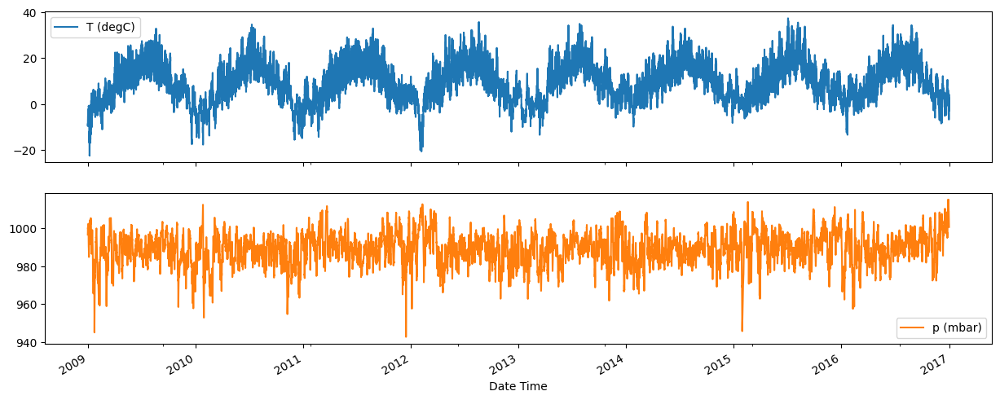

In [32]:
# let's plot the data
plot_cols = ['T (degC)', 'p (mbar)']
plot_features = df[plot_cols]
plot_features.index = date_time
plot_features.plot(subplots=True)

array([<Axes: xlabel='Date Time'>, <Axes: xlabel='Date Time'>],
      dtype=object)

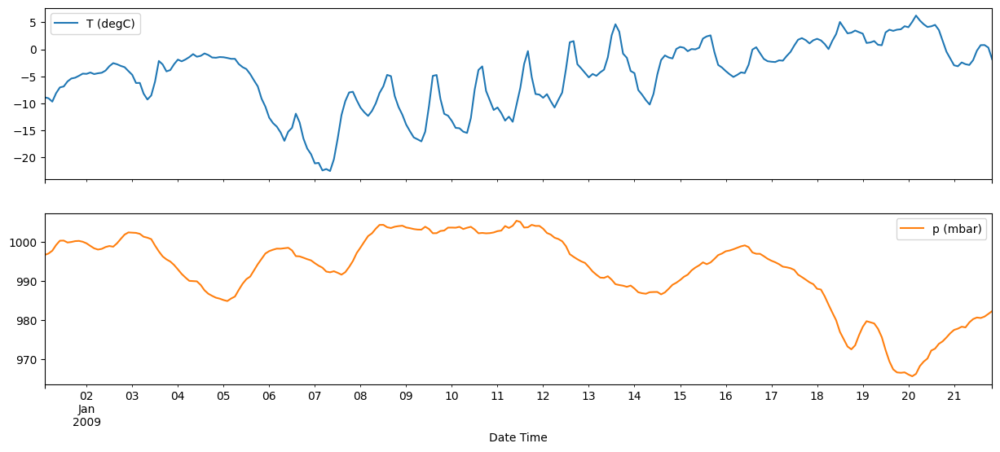

In [33]:
# lets plot only the first 500 hours dataset which is equal to 250 records
# let's plot the data
plot_cols = ['T (degC)', 'p (mbar)']
plot_features = df[plot_cols][:250]
plot_features.index = date_time[:250]
plot_features.plot(subplots=True)

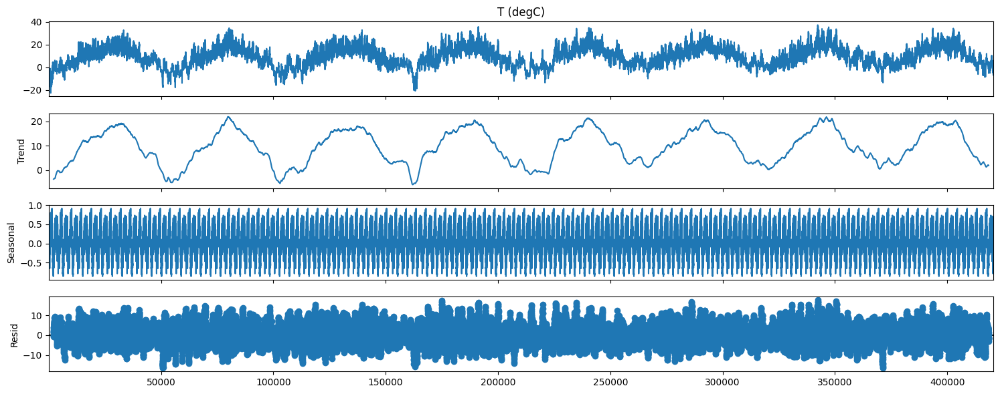

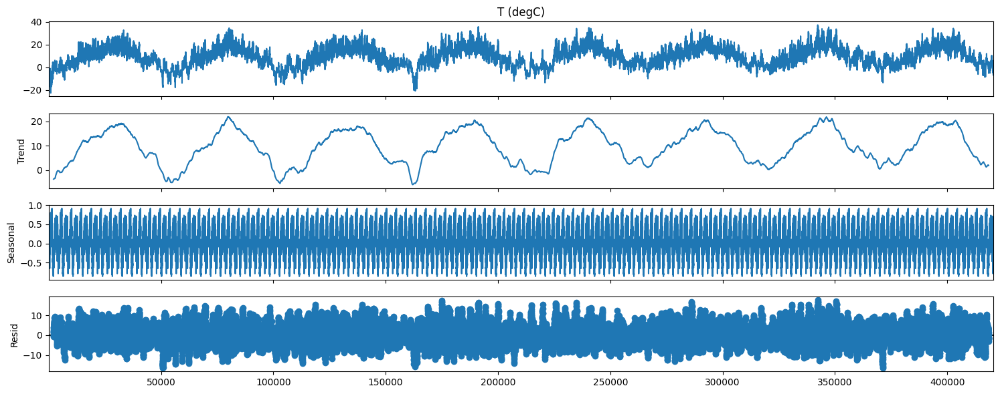

In [34]:
# lets decompose the data into trend, seasonality and noise
# we will use the seasonal_decompose function from statsmodels library
decompose = seasonal_decompose(df['T (degC)'], model='additive', period=365)
decompose.plot()

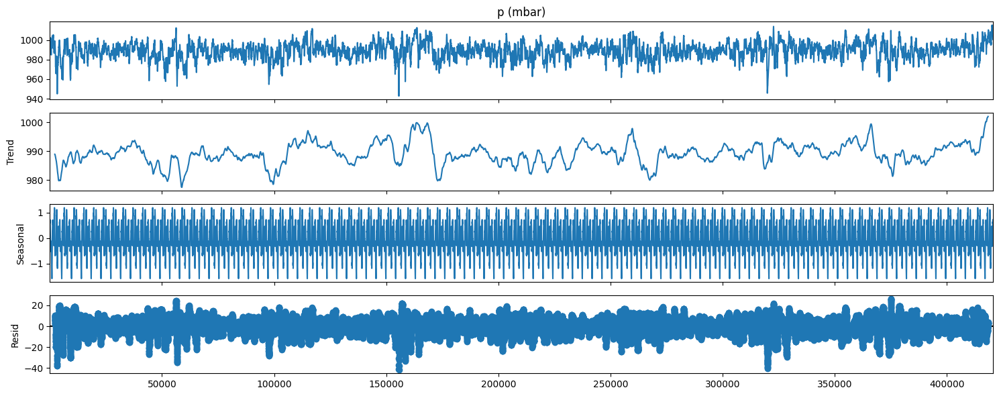

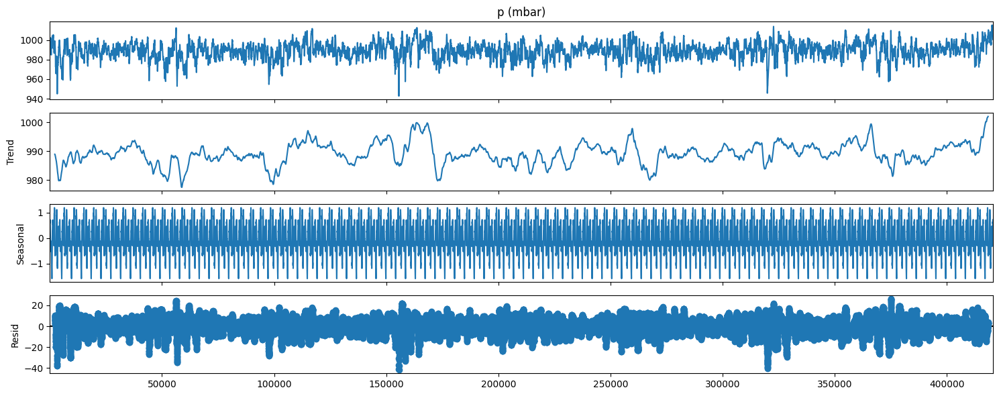

In [35]:
decompose = seasonal_decompose(df['p (mbar)'], model='additive', period=365)
decompose.plot()

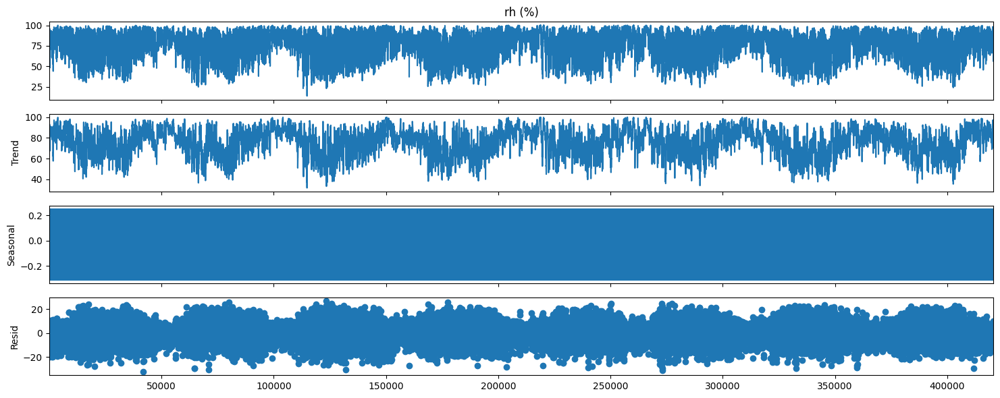

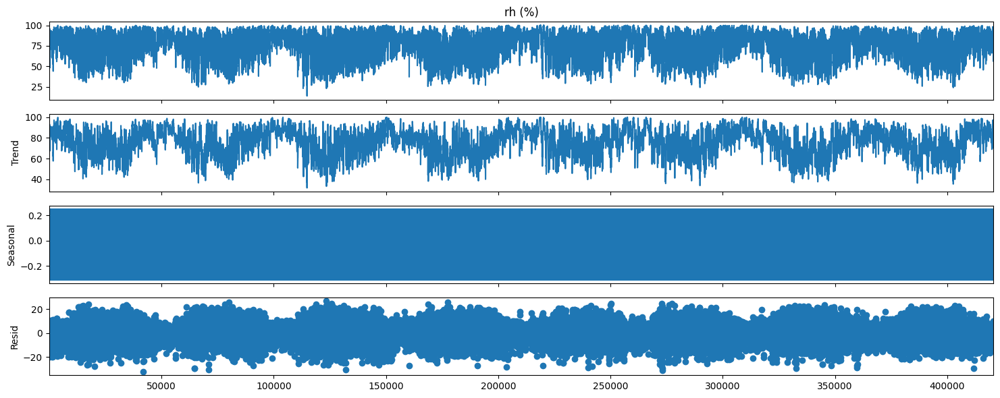

In [36]:
decompose = seasonal_decompose(df['rh (%)'], model='additive', period=8)
decompose.plot()

In [37]:
df.isnull()

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
11,False,False,False,False,False,False,False,False,False,False,False,False,False,False
23,False,False,False,False,False,False,False,False,False,False,False,False,False,False
35,False,False,False,False,False,False,False,False,False,False,False,False,False,False
47,False,False,False,False,False,False,False,False,False,False,False,False,False,False
59,False,False,False,False,False,False,False,False,False,False,False,False,False,False
71,False,False,False,False,False,False,False,False,False,False,False,False,False,False
83,False,False,False,False,False,False,False,False,False,False,False,False,False,False
95,False,False,False,False,False,False,False,False,False,False,False,False,False,False
107,False,False,False,False,False,False,False,False,False,False,False,False,False,False
119,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [38]:
# lets plot the same plots in plotly
fig = px.line(df, x=date_time, y='T (degC)')
fig.show()
fig = px.line(df, x=date_time, y='p (mbar)')
fig.update_traces(line_color='red')
fig.show()


In [39]:
# clean up the data
# lets check if there are any null values in the dataset
df.isnull().sum()

p (mbar)           0
T (degC)           0
Tpot (K)           0
Tdew (degC)        0
rh (%)             0
VPmax (mbar)       0
VPact (mbar)       0
VPdef (mbar)       0
sh (g/kg)          0
H2OC (mmol/mol)    0
rho (g/m**3)       0
wv (m/s)           0
max. wv (m/s)      0
wd (deg)           0
dtype: int64

In [40]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
p (mbar),35045.0,989.213079,8.353850,942.65,984.20,989.57,994.72,1015.16
T (degC),35045.0,9.450335,8.425301,-22.50,3.36,9.43,15.49,37.28
Tpot (K),35045.0,283.492908,8.506133,251.22,277.44,283.48,289.55,311.21
Tdew (degC),35045.0,4.955012,6.729168,-24.55,0.24,5.22,10.08,22.19
rh (%),35045.0,76.006020,16.483440,13.88,65.15,79.30,89.50,100.00
VPmax (mbar),35045.0,13.577314,7.743076,0.99,7.77,11.83,17.62,63.77
VPact (mbar),35045.0,9.532714,4.181965,0.83,6.22,8.86,12.36,26.79
VPdef (mbar),35045.0,4.044542,4.902793,0.00,0.87,2.18,5.30,46.01
sh (g/kg),35045.0,6.021744,2.654692,0.52,3.92,5.60,7.81,17.13
H2OC (mmol/mol),35045.0,9.639148,4.233082,0.83,6.29,8.97,12.49,27.25


In [41]:
wv = df['wv (m/s)']
bad_wv = wv == -9999.0  
wv[bad_wv] = 0.0

In [42]:
max_wv = df['max. wv (m/s)']
bad_max_wv = max_wv == -9999.0
max_wv[bad_max_wv] = 0.0


In [43]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
p (mbar),35045.0,989.213079,8.353850,942.65,984.20,989.57,994.72,1015.16
T (degC),35045.0,9.450335,8.425301,-22.50,3.36,9.43,15.49,37.28
Tpot (K),35045.0,283.492908,8.506133,251.22,277.44,283.48,289.55,311.21
Tdew (degC),35045.0,4.955012,6.729168,-24.55,0.24,5.22,10.08,22.19
rh (%),35045.0,76.006020,16.483440,13.88,65.15,79.30,89.50,100.00
VPmax (mbar),35045.0,13.577314,7.743076,0.99,7.77,11.83,17.62,63.77
VPact (mbar),35045.0,9.532714,4.181965,0.83,6.22,8.86,12.36,26.79
VPdef (mbar),35045.0,4.044542,4.902793,0.00,0.87,2.18,5.30,46.01
sh (g/kg),35045.0,6.021744,2.654692,0.52,3.92,5.60,7.81,17.13
H2OC (mmol/mol),35045.0,9.639148,4.233082,0.83,6.29,8.97,12.49,27.25


# Modeling

In [44]:
df.shape

(35045, 14)

In [45]:
# split the data into train, validation and test i have 35045 records make 70% for training, 20% for validation and 10% for testing
# 70% of 35045 is 24531
# 20% of 35045 is 7009
# 10% of 35045 is 3505
# total 35045
# train data
train_df = df[:24531]
# validation data
val_df = df[24531:31540]
# test data
test_df = df[31540:]

# lets check the shape of the data
train_df.shape, val_df.shape, test_df.shape

((24531, 14), (7009, 14), (3505, 14))

array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >], dtype=object)

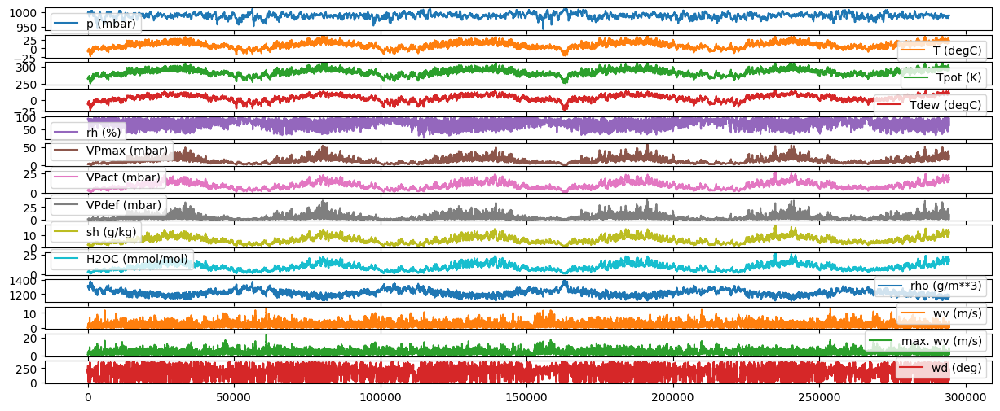

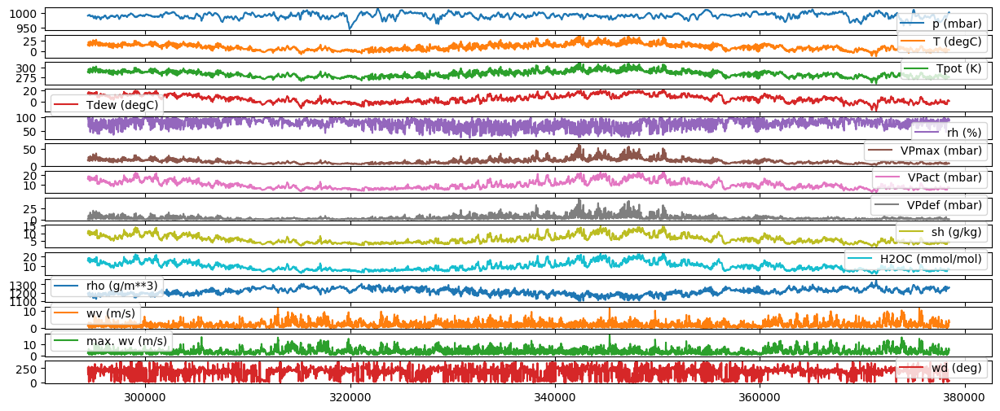

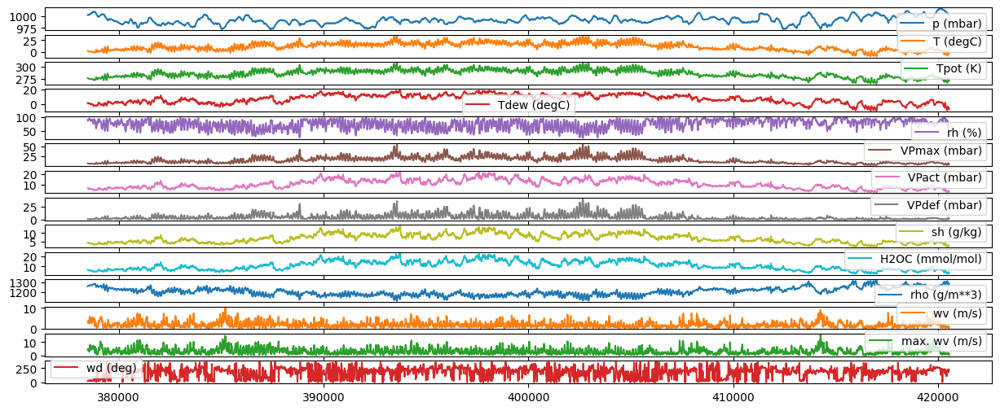

In [46]:
# lets plot the data
train_df.plot(subplots=True)

# lets plot the data
val_df.plot(subplots=True)

# lets plot the data
test_df.plot(subplots=True)


In [47]:
# lets normalize the data
# we will use the mean and standard deviation of the training data to normalize the data
train_mean = train_df.mean()
train_std = train_df.std()

# lets normalize the training data
train_df = (train_df - train_mean) / train_std
# lets normalize the validation data
val_df = (val_df - train_mean) / train_std
# lets normalize the test data
test_df = (test_df - train_mean) / train_std

array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >], dtype=object)

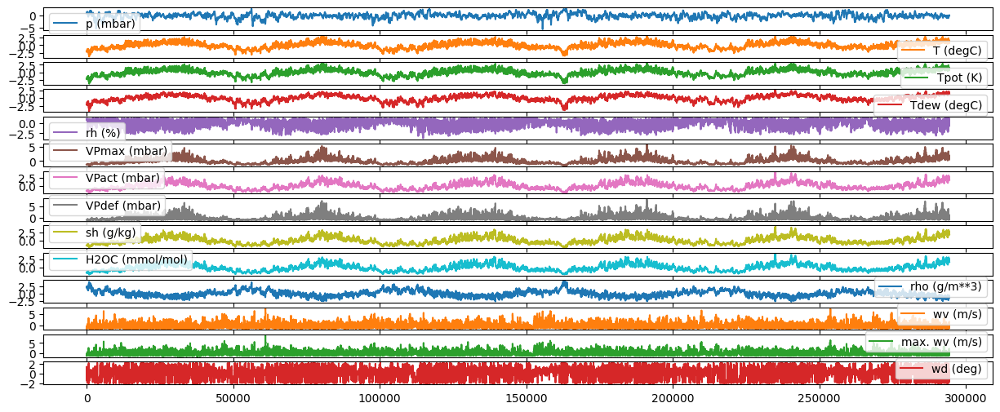

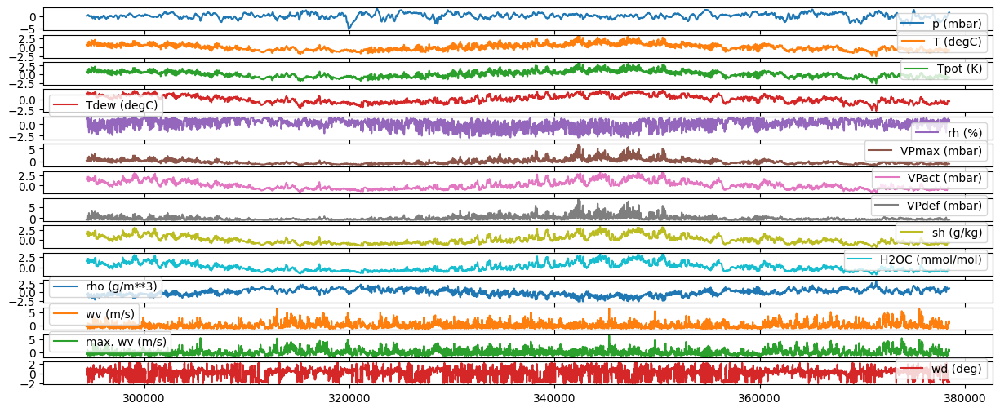

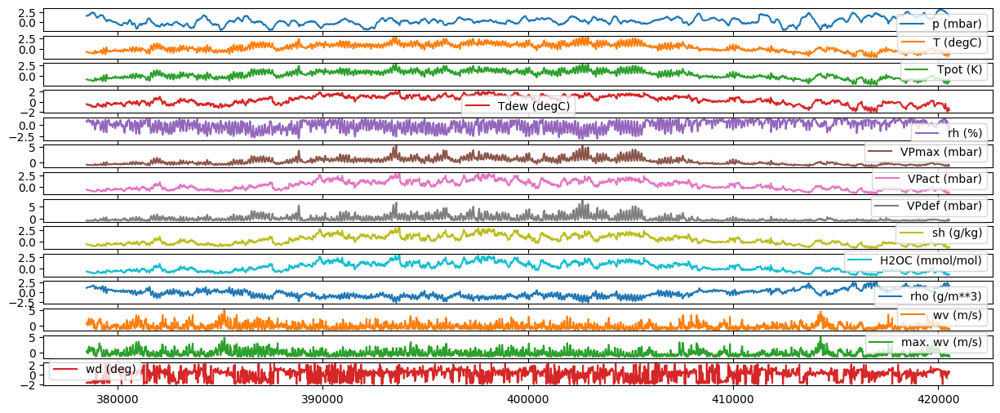

In [48]:
# lets plot the data
train_df.plot(subplots=True)

# lets plot the data
val_df.plot(subplots=True)

# lets plot the data
test_df.plot(subplots=True)


In [49]:
# lets make the model to predict the temperature
# lets make the windowed dataset
# we will use the windowed dataset to train the model
# we will use the windowed dataset to validate the model
# we will use the windowed dataset to test the model
# we will use the windowed dataset to predict the model
# we will use the windowed dataset to plot the model

# lets make the windowed datas